In [1]:
#!pip install malariagen_data

In [2]:
import malariagen_data
import pandas as pd

In [3]:
ag3=malariagen_data.Ag3()

In [4]:
samples_df=ag3.sample_metadata()

Load sample metadata:   0%|          | 0/28 [00:00<?, ?it/s]

In [9]:
#get all far west for selected taxon
far_west_samples_df=samples_df.query('country in ["Ghana", "Burkina Faso", "Guinea", "Guinea-Bissau", "Cote d\'Ivoire", "Mali", "Gambia, The"] and taxon in ["gambiae","coluzzii","gcx1","gcx2"]')

In [10]:
#get all far west #get cohorts with >5 samples
filtered_far_west_df=far_west_samples_df.query('country in ["Ghana", "Burkina Faso", "Guinea", "Guinea-Bissau", "Cote d\'Ivoire", "Mali", "Gambia, The"]').groupby(['country', 'location','taxon']).filter(lambda x: len(x) >= 5)

In [11]:
#get cohort names
filtered_far_west_df['cohort_admin1_year'].unique()

array(['BF-09_gamb_2012', 'BF-09_colu_2012', 'BF-09_colu_2014',
       'BF-09_gamb_2014', 'BF-07_gamb_2004', 'CI-LG_colu_2012',
       'GH-CP_colu_2012', 'GH-WP_colu_2012', 'GH-AA_gamb_2012',
       'GH-AA_colu_2012', 'GH-EP_gamb_2012', 'GM-N_gcx1_2011',
       'GM-N_gcx2_2011', 'GM-L_gcx2_2012', 'GM-N_gcx1_2012',
       'GM-M_gcx2_2012', 'GN-N_gamb_2012', 'GN-F_gamb_2012',
       'GN-N_colu_2012', 'ML-3_gamb_2012', 'ML-3_colu_2012',
       'GW-BS_gcx1_2010', 'GW-GA_gamb_2010', 'GW-BM_gcx1_2010',
       'ML-2_colu_2014', 'ML-2_gamb_2014', 'ML-2_gamb_2004',
       'ML-4_colu_2004', 'ML-2_colu_2004'], dtype=object)

In [18]:
cohorts_dict={
#gambiae
"BFgam":"taxon == 'gambiae' and country == 'Burkina Faso' and year!=2004",
"GHgam":"taxon == 'gambiae' and country == 'Ghana'",
"GNgam":"taxon == 'gambiae' and country == 'Guinea'",
"GWgam":"taxon == 'gambiae' and country == 'Guinea-Bissau'",
"MAgam":"taxon == 'gambiae' and country == 'Mali' and year != 2004",
#coluzzii
"BFcol":"taxon == 'coluzzii' and country == 'Burkina Faso'",
"CIcol":'taxon == "coluzzii" and country == "Cote d\'Ivoire"', 
"GHcol":"taxon == 'coluzzii' and country == 'Ghana'",
"GNcol":"taxon == 'coluzzii' and country == 'Guinea'",
"MAcol":'taxon == "coluzzii" and country == "Mali" and year !=2004',
#gcx2-gm1
"gcx2":"taxon == 'gcx2' and country == 'Gambia, The'",
#gcx1-gm2
"gcx1-GM":"taxon == 'gcx1' and country == 'Gambia, The'",
#gcx1-gw1
"gcx1-GW":"taxon == 'gcx1' and country == 'Guinea-Bissau'"}

In [19]:
try:
    from google.colab import drive
    drive.mount("drive")
except ImportError:
    pass

Metabolic resistance markers

In [20]:
#cyp6 cluster 2R:28,460,000-28,580,000
cyp6_cnv_df = ag3.gene_cnv_frequencies(region="2R:28,480,000-28,510,000", cohorts=cohorts_dict, min_cohort_size=5)

Load CNV HMM data:   0%|          | 0/504 [00:00<?, ?it/s]

Compute modal gene copy number:   0%|          | 0/11 [00:00<?, ?it/s]

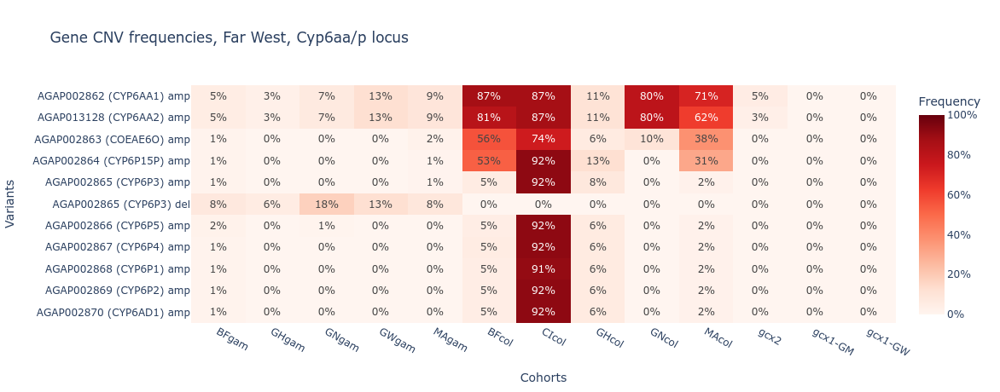

In [21]:
ag3.plot_frequencies_heatmap(
    cyp6_cnv_df.query("max_af > 0.05"), 
    title="Gene CNV frequencies, Far West, Cyp6aa/p locus"
)

In [22]:
#CYP9K1 X:15,240,572-15,242,864
cyp9k1_cnv_df = ag3.gene_cnv_frequencies(region="X:15,240,572-15,242,864", cohorts=cohorts_dict, min_cohort_size=5)

Load CNV HMM data:   0%|          | 0/252 [00:00<?, ?it/s]

Compute modal gene copy number:   0%|          | 0/1 [00:00<?, ?it/s]

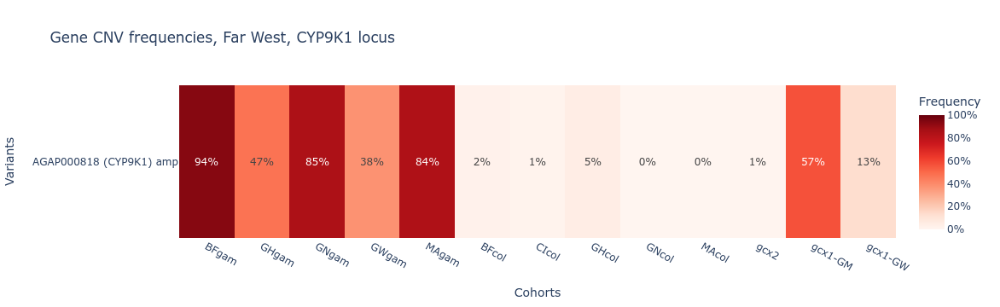

In [23]:
ag3.plot_frequencies_heatmap(
    cyp9k1_cnv_df.query("max_af > 0.05"), 
    title="Gene CNV frequencies, Far West, CYP9K1 locus"
)

In [24]:
#cyp6m2 "3R:6,924,000-6,980,000"
cyp6m2_cnv_df = ag3.gene_cnv_frequencies(region="3R:6,924,000-6,980,000", cohorts=cohorts_dict, min_cohort_size=5)

Load CNV HMM data:   0%|          | 0/378 [00:00<?, ?it/s]

Compute modal gene copy number:   0%|          | 0/9 [00:00<?, ?it/s]

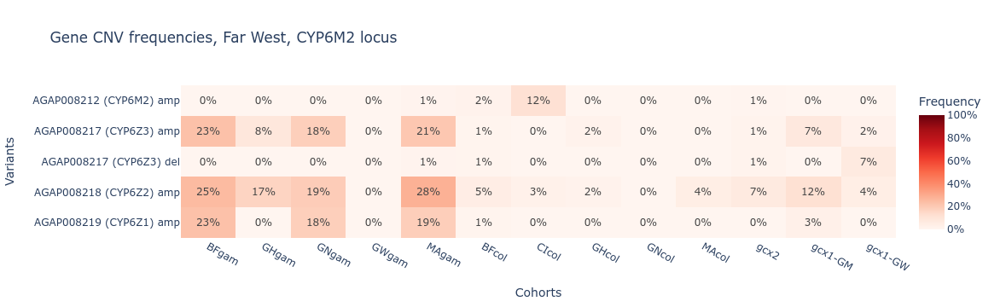

In [25]:
ag3.plot_frequencies_heatmap(
    cyp6m2_cnv_df.query("max_af > 0.05"), 
    title="Gene CNV frequencies, Far West, CYP6M2 locus"
)

Target-site and metabolic resistance markers

In [26]:
gste_aa_freqs_df = ag3.aa_allele_frequencies(
    transcript="AGAP009194-RA", 
    cohorts=cohorts_dict,
    min_cohort_size=5,
)
gste_aa_freqs_df = gste_aa_freqs_df.query("max_af > 0.05")

Load SNP genotypes:   0%|          | 0/148 [00:00<?, ?it/s]

Compute allele frequencies:   0%|          | 0/13 [00:00<?, ?it/s]

Compute SNP effects:   0%|          | 0/338 [00:00<?, ?it/s]

In [27]:
#gste2 3R:28,597,652-28,598,640
gste2_cnv_df = ag3.gene_cnv_frequencies(region="3R:28,597,652-28,598,640", cohorts=cohorts_dict, min_cohort_size=5)

gste2_cnv_df = gste2_cnv_df.query("max_af > 0.05")

Load CNV HMM data:   0%|          | 0/378 [00:00<?, ?it/s]

Compute modal gene copy number:   0%|          | 0/1 [00:00<?, ?it/s]

In [28]:
gste2_combined_df = pd.concat(
    [gste_aa_freqs_df, gste2_cnv_df], 
    axis=0,  # concatenate rows
)

In [29]:
frq_cols = [col for col in gste2_combined_df.columns if 'frq' in col]
frq_cols.append("label")
gste2_combined_cols_df= gste2_combined_df[frq_cols].copy()

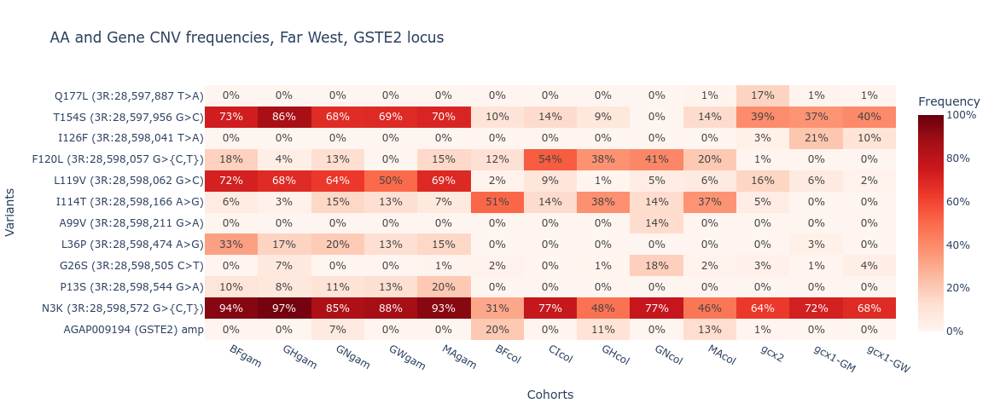

In [30]:
ag3.plot_frequencies_heatmap(
    gste2_combined_cols_df, 
    title="AA and Gene CNV frequencies, Far West, GSTE2 locus"
)

In [31]:
#ace1 "2R:3,300,000-4,000,000"
ace1_aa_freqs_df = ag3.aa_allele_frequencies(
    transcript="AGAP001356-RA", 
    cohorts=cohorts_dict,
    min_cohort_size=5,
)

ace1_aa_freqs_df = ace1_aa_freqs_df.query("max_af > 0.05")

Load SNP genotypes:   0%|          | 0/148 [00:00<?, ?it/s]

Compute allele frequencies:   0%|          | 0/13 [00:00<?, ?it/s]

Compute SNP effects:   0%|          | 0/9606 [00:00<?, ?it/s]

In [32]:
ace1_cnv_df = ag3.gene_cnv_frequencies(region="2R:3,300,000-4,000,000", cohorts=cohorts_dict, min_cohort_size=5)

ace1_cnv_df = ace1_cnv_df.query("max_af > 0.05")

Load CNV HMM data:   0%|          | 0/504 [00:00<?, ?it/s]

Compute modal gene copy number:   0%|          | 0/36 [00:00<?, ?it/s]

In [33]:
ace1_combined_df = pd.concat(
    [ace1_aa_freqs_df, ace1_cnv_df], 
    axis=0,  # concatenate rows
)

In [34]:
frq_cols = [col for col in ace1_combined_df.columns if 'frq' in col]
frq_cols.append("label")
ace1_combined_cols_df= ace1_combined_df[frq_cols].copy()

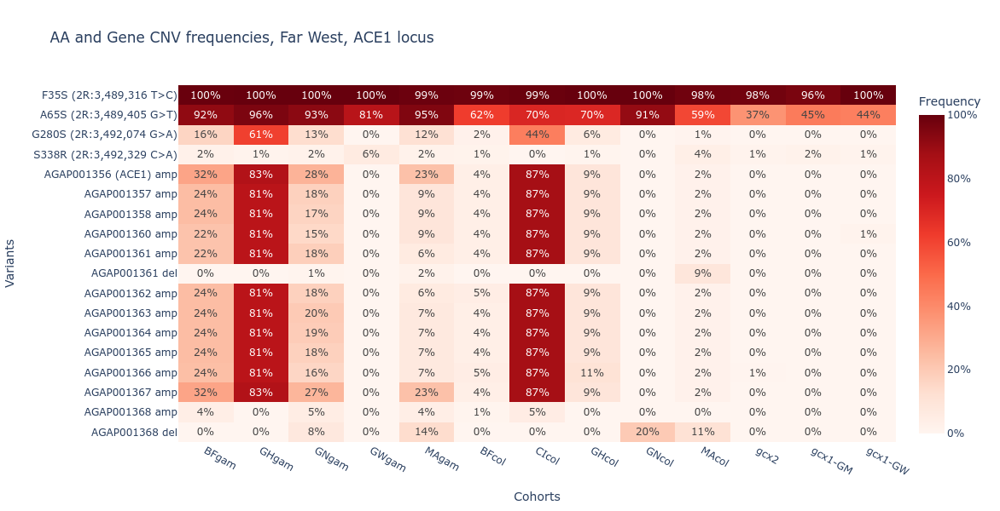

In [35]:
ag3.plot_frequencies_heatmap(
    ace1_combined_cols_df, 
    title="AA and Gene CNV frequencies, Far West, ACE1 locus"
)

Target site resistance markers

In [36]:
#vgsc 2L:2,358,158..2,431,617 
vgsc_aa_freqs_df = ag3.aa_allele_frequencies(
    transcript="AGAP004707-RD", 
    cohorts=cohorts_dict,
    min_cohort_size=5,
)

Load SNP genotypes:   0%|          | 0/296 [00:00<?, ?it/s]

Compute allele frequencies:   0%|          | 0/13 [00:00<?, ?it/s]

Compute SNP effects:   0%|          | 0/25698 [00:00<?, ?it/s]

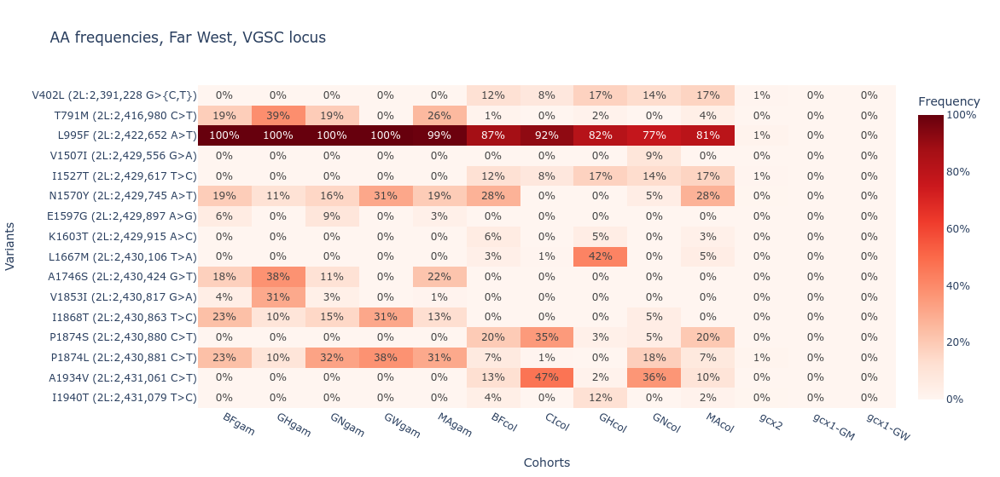

In [37]:
ag3.plot_frequencies_heatmap(
    vgsc_aa_freqs_df.query("max_af > 0.05"), 
    title="AA frequencies, Far West, VGSC locus"
)

In [38]:
#tep1 3L:11,201,863-11,206,930 
tep1_aa_freqs_df = ag3.aa_allele_frequencies(
    transcript="AGAP010815-RA", 
    cohorts=cohorts_dict,
    min_cohort_size=5,
    drop_invariant=True,
)

Load SNP genotypes:   0%|          | 0/148 [00:00<?, ?it/s]

Compute allele frequencies:   0%|          | 0/13 [00:00<?, ?it/s]

Compute SNP effects:   0%|          | 0/2527 [00:00<?, ?it/s]

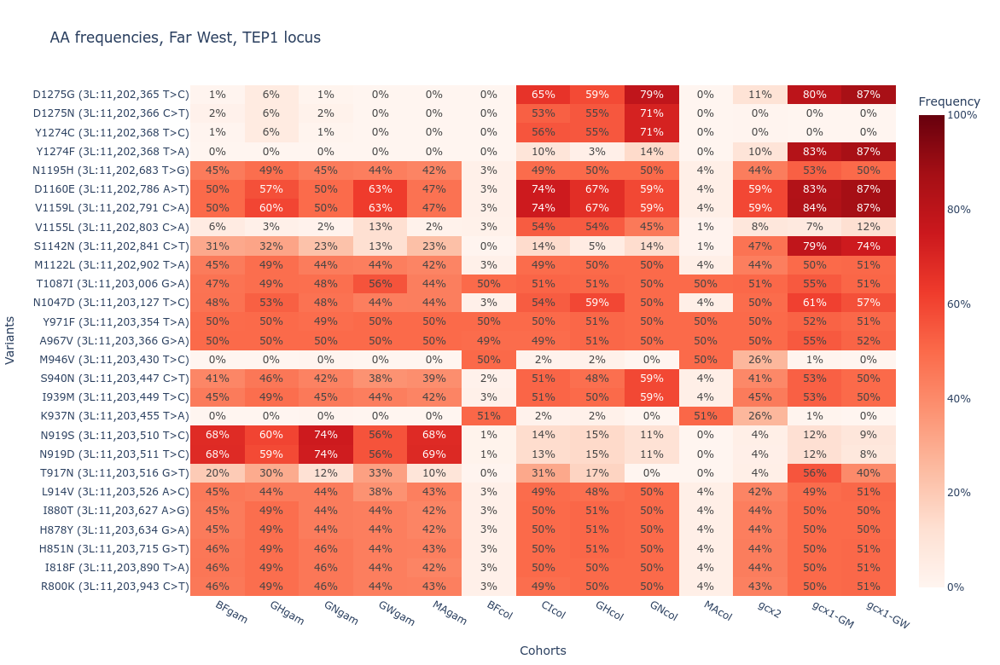

In [39]:
ag3.plot_frequencies_heatmap(
    tep1_aa_freqs_df.query("max_af > 0.5 and max_af < 0.90"),
    title="AA frequencies, Far West, TEP1 locus"
)

In [40]:
#kelch 19 protein region 2R:40,926,195-40,945,169 AGAP003645-RA
kelch19_aa_freqs_df = ag3.aa_allele_frequencies(
    transcript="AGAP003645-RA", 
    cohorts=cohorts_dict,
    min_cohort_size=5,
)

Load SNP genotypes:   0%|          | 0/148 [00:00<?, ?it/s]

Compute allele frequencies:   0%|          | 0/13 [00:00<?, ?it/s]

Compute SNP effects:   0%|          | 0/20670 [00:00<?, ?it/s]

In [ ]:
ag3.plot_frequencies_heatmap(
    kelch19_aa_freqs_df.query("max_af > 0.1 & effect == 'NON_SYNONYMOUS_CODING'"),
    title="AA frequencies, Far West, Kelch-19 locus"
)

In [42]:
#rdl 2L:25,363,652..25,434,556 AGAP006028-RA
rdl_aa_freqs_df = ag3.aa_allele_frequencies(
    transcript="AGAP006028-RA", 
    cohorts=cohorts_dict,
    min_cohort_size=5,
)

Load SNP genotypes:   0%|          | 0/148 [00:00<?, ?it/s]

Compute allele frequencies:   0%|          | 0/13 [00:00<?, ?it/s]

Compute SNP effects:   0%|          | 0/48058 [00:00<?, ?it/s]

In [ ]:
ag3.plot_frequencies_heatmap(
    rdl_aa_freqs_df.query("max_af > 0.05 & effect == 'NON_SYNONYMOUS_CODING'"),
    title="AA frequencies, Far West, Rdl locus"
)

In [44]:
#coeae2f 2L:28,548,433..28,550,748 AGAP006228-RA
coeae2f_aa_freqs_df = ag3.aa_allele_frequencies(
    transcript="AGAP006228-RA", 
    cohorts=cohorts_dict,
    min_cohort_size=5,
)

Load SNP genotypes:   0%|          | 0/148 [00:00<?, ?it/s]

Compute allele frequencies:   0%|          | 0/13 [00:00<?, ?it/s]

Compute SNP effects:   0%|          | 0/1204 [00:00<?, ?it/s]

In [ ]:
ag3.plot_frequencies_heatmap(
    coeae2f_aa_freqs_df.query("max_af > 0.05 & effect == 'NON_SYNONYMOUS_CODING'"),
    title="AA frequencies, Far West, Coeae2f locus"
)

# Selection scans

In [49]:
#GWgam cohort small, removed to allow looping.
cohorts_dict={
#gambiae
"BFgam":"taxon == 'gambiae' and country == 'Burkina Faso' and year!=2004",
"GHgam":"taxon == 'gambiae' and country == 'Ghana'",
"GNgam":"taxon == 'gambiae' and country == 'Guinea'",
#"GWgam":"taxon == 'gambiae' and country == 'Guinea-Bissau'",
"MAgam":"taxon == 'gambiae' and country == 'Mali' and year != 2004",
#coluzzii
"BFcol":"taxon == 'coluzzii' and country == 'Burkina Faso'",
"CIcol":'taxon == "coluzzii" and country == "Cote d\'Ivoire"', 
"GHcol":"taxon == 'coluzzii' and country == 'Ghana'",
"GNcol":"taxon == 'coluzzii' and country == 'Guinea'",
"MAcol":'taxon == "coluzzii" and country == "Mali" and year !=2004',
#gcx2-gm1
"gcx2":"taxon == 'gcx2' and country == 'Gambia, The'",
#gcx1-gm2
"gcx1-GM":"taxon == 'gcx1' and country == 'Gambia, The'",
#gcx1-gw1
"gcx1-GW":"taxon == 'gcx1' and country == 'Guinea-Bissau'"}

In [47]:
# check optimal window size
for cohort, cohort_query in cohorts_dict.items():
    ag3.plot_h12_calibration(
        contig="3L",
        sample_sets="3.0",
        analysis="gamb_colu",
        sample_query=cohort_query,
        cohort_size=10,
    )

Load haplotypes:   0%|          | 0/440 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/176 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/352 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/264 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/352 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/176 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/176 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/264 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/176 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/352 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/264 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/176 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

In [50]:
window_size_dict={
#gambiae
"BFgam":2000,
"GHgam":10000,
"GNgam":2000,
#"GWgam":2000,
"MAgam":2000,
#coluzzii
"BFcol":1000,
"CIcol":10000, 
"GHcol":5000,
"GNcol":10000,
"MAcol":1000,
#gcx2-gm1
"gcx2":1000,
#gcx1-gm2
"gcx1-GM":10000,
#gcx1-gw1
"gcx1-GW":2000}

# 2L

In [51]:
for cohort, cohort_query in cohorts_dict.items():
    ag3.plot_h12_gwss(
        contig="2L", 
        analysis="gamb_colu", 
        window_size=window_size_dict[cohort],  
        sample_query=cohort_query,
        cohort_size=10,
        title=cohort
    )

Load haplotypes:   0%|          | 0/570 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/228 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/456 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/342 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/456 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/228 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/228 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/342 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/228 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/456 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/342 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/228 [00:00<?, ?it/s]

# 2R

In [52]:
for cohort, cohort_query in cohorts_dict.items():
    ag3.plot_h12_gwss(
        contig="2R", 
        analysis="gamb_colu", 
        window_size=window_size_dict[cohort],  
        sample_query=cohort_query,
        cohort_size=10,
        title=cohort
    )

Load haplotypes:   0%|          | 0/690 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/276 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/552 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/414 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/552 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/276 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/276 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/414 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/276 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/552 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/414 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/276 [00:00<?, ?it/s]

# 3L

In [53]:
for cohort, cohort_query in cohorts_dict.items():
    ag3.plot_h12_gwss(
        contig="3L", 
        analysis="gamb_colu", 
        window_size=window_size_dict[cohort],  
        sample_query=cohort_query,
        cohort_size=10,
        title=cohort
    )

Load haplotypes:   0%|          | 0/440 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/176 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/352 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/264 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/352 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/176 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/176 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/264 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/176 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/352 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/264 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/176 [00:00<?, ?it/s]

# 3R

In [54]:
for cohort, cohort_query in cohorts_dict.items():
    ag3.plot_h12_gwss(
        contig="3R", 
        analysis="gamb_colu", 
        window_size=window_size_dict[cohort],  
        sample_query=cohort_query,
        cohort_size=10,
        title=cohort
    )

Load haplotypes:   0%|          | 0/580 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/232 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/464 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/348 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/464 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/232 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/232 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/348 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/232 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/464 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/348 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/232 [00:00<?, ?it/s]

# X

In [55]:
for cohort, cohort_query in cohorts_dict.items():
    ag3.plot_h12_gwss(
        contig="X", 
        analysis="gamb_colu", 
        window_size=window_size_dict[cohort],  
        sample_query=cohort_query,
        cohort_size=10,
        title=cohort
    )

Load haplotypes:   0%|          | 0/260 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/104 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/208 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/156 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/208 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/104 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/104 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/156 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/104 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/208 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/156 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/104 [00:00<?, ?it/s]

# Far West

In [56]:
cohorts_dict={
"gcx2":"taxon == 'gcx2' and country == 'Gambia, The'",
"gcx1-GM":"taxon == 'gcx1' and country == 'Gambia, The'",
"gcx1-GW":"taxon == 'gcx1' and country == 'Guinea-Bissau'"}

In [57]:
# check optimal window size
for cohort, cohort_query in cohorts_dict.items():
    ag3.plot_h12_calibration(
        contig="X",
        sample_sets="3.0",
        analysis="gamb_colu",
        sample_query=cohort_query,
        cohort_size=10,
    )

Load haplotypes:   0%|          | 0/208 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/156 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/104 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

In [61]:
window_size_dict={
"gcx2":1000,
"gcx1-GM":5000,
"gcx1-GW":2000}

In [62]:
for cohort, cohort_query in cohorts_dict.items():
    ag3.plot_h12_gwss(
        contig="X", 
        analysis="gamb_colu", 
        window_size=window_size_dict[cohort],  
        sample_query=cohort_query,
        cohort_size=10,
        title=cohort
    )

Load haplotypes:   0%|          | 0/208 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/156 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/104 [00:00<?, ?it/s]